<div style="background-color:	#216375 ; text-align:center; vertical-align: middle; padding:40px 0; margin-top:30px">
<h1 style="color:white">Deep Learning - Karaoke klassificatie</h1>
<b style="color:black"> Kaggle: Yoyoyoghurt(teamnaam), JortAkershoek, juliaboschman, Sam Keesen </b>
   
<b style="color:white"> Jort Akershoek, Julia Boschman, Sam Keesen</b>
    </div>

<a name='start'></a>

## Table of contents

1. [H1: Inleiding](#1.0)
2. [H2: EDA](#2.0)
    - [&sect;2.1: Audio fragmenten](#2.1)
    - [&sect;2.2: Eigenschappen audio fragmenten](#2.2)
    - [&sect;2.3: Songteksten](#2.3)
    - [&sect;2.4: Conclusie EDA](#2.4)
3. [H3: LSTM voor audioclips](#3.0)
    - [&sect;3.1: Feature engineering](#3.1)
    - [&sect;3.2: Het model](#3.2)
    - [&sect;3.3: Modelarchitectuur](#3.3)
    - [&sect;3.4: Stappen feature engineering](#3.4)
    - [&sect;3.5: Onderbouwing keuzes parameters](#3.5)
    - [&sect;3.6: Geschikte loss functie en optimizer](#3.6)
    - [&sect;3.7: Model trainen](#3.7)
    - [&sect;3.8: Loss visualisatie](#3.8)
    - [&sect;3.9: Functie voor kaggle](#3.9)
4. [H4: LSTM voor songteksten](#4.0)
    - [&sect;4.1: Datapipeline met data preprocessing, feature engineering, of/en data augmentation](#4.1)
    - [&sect;4.2: Het model](#4.2)
    - [&sect;4.3: Modelarchitectuur](#4.3)
    - [&sect;4.4: Onderbouwing keuzes parameters](#4.4)
    - [&sect;4.5: Model trainen](#4.5)
5. [H5: Transformer voor songteksten](#5.0)
    - [&sect;5.1: Het model](#5.1)
    - [&sect;5.2: Fine-tuning Hugging Face](#5.2)
    - [&sect;5.3: Naam modelarchitectuur en dataset](#5.3)
    - [&sect;5.4: Voordelen vooraf getrainde tekst modellen](#4.4)
    - [&sect;5.5: Stappen finetunen vooraf getraind model en motivaties](#5.5)
6. [H6: Model naar keuze](#6.0)
    - [&sect;6.1: Het model](#6.1)
    - [&sect;6.2: Modelarchitectuur](#6.2)
    - [&sect;6.3: Uitleg keuzes model](#6.3)
7. [H7: Bevindingen](#7.0)
    - [&sect;7.1: Samenvatting van de uitkomst](#7.1)
8. [H8: Conclusie en aanbevelingen](#8.0)
    - [&sect;8.1: Uitdagingen modelleringsproces](#8.1)
    - [&sect;8.2: Prestaties modelarchitecturen](#8.2)
    - [&sect;8.3: Beste model audio en tekst](#8.3)
    - [&sect;8.4: Genres makkelijk te voorspellen met audio en tekst](#8.4)
    - [&sect;8.5: Advies voor app](#8.5)
    - [&sect;8.6: Conceptuele uitbreiding voor systeem](#8.6)
9. [H9: Literatuurlijst](#9.0)

In [10]:
#alle nodige imports
import os
import wave
import random
import pathlib
import numpy as np
import pandas as pd
import seaborn as sns
import soundfile as sf
import tensorflow as tf
from IPython import display
from tensorflow import keras
import IPython.display as ipd
from collections import Counter
import matplotlib.pyplot as plt
from tensorflow.keras import regularizers
from tensorflow.keras import layers, models
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.layers import Embedding, SpatialDropout1D
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import LSTM, Dropout, Dense, Bidirectional, BatchNormalization
import torch
from transformers import AutoModelForSequenceClassification, AutoTokenizer, Trainer, TrainingArguments, AutoConfig
from datasets import load_metric
from torchviz import make_dot 

In [3]:
os.environ["PATH"] += os.pathsep + 'C:/Program Files/Graphviz/bin/'

Voor het plotten van de model architectuur voeren wij aan het begin van ons notebook een regel code uit die verwijs naar de plek waar het bestand staat opgeslagen. Zo kunnen wij makkelijk iedere model architectuur laten zien wanneer deze getoond moet worden, na elk opgesteld model.

[Back to the top](#start)
<a name='1.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H1: Inleiding</strong></h2>
</div>

Voor het vak Deep Learning wordt er in dit portfolio onderzoek gedaan naar de werking en toepassing van verschillende vormen van neurale netwerken. De opdracht voor dit portfolio is het voorspellen van genres van liedjes met de hulp van neurale netwerken. Dit kunnen neurale netwerken zijn die alleen werken met tekst data, juist alleen met audio data of zelfs met beide. Er worden 4 verschillende neurale netwerken gebruikt in dit notebook en dat zijn als volgt:

- LSTM neuraal netwerk, alleen audio data.
- LSTM neuraal netwerk, alleen tekst data.
- Transformer model, alleen tekst data.
- Een model naar keuze, kan zowel audio als tekst data, of beide.

Aan het einde van het notebook gaan wij reflecteren op de manier(en) die het beste resultaat heeft geleverd voor ons vraagstuk. Hier zal worden gekeken naar het model, maar ook wat de reden zou kunnen zijn dat het model beter werkt dan de andere.

[Back to the top](#start)
<a name='2.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H2: EDA</strong></h2>
</div>

<a name='2.1'></a>
<h3>&sect;2.1: Audio fragmenten</h3>

Als aller eerste stap zullen wij de audio data inladen, zodat wij deze later kunnen gebruiken in een LSTM model. Hierin verdelen wij de data onder train en validation data. Deze validation data wordt in de cel daaronder weer onderverdeeld in validation en test data. Wij hebben er voor gekozen om de data te verwerken in batches van 8, zodat het model niet te veel kracht nodig heeft om te kunnen runnen.

In [3]:
base_dir = "Train"

data_dir = pathlib.Path(base_dir)

train_ds, val_ds = tf.keras.utils.audio_dataset_from_directory(
    directory=data_dir,
    batch_size=8,
    validation_split=0.2,
    seed=0,
    output_sequence_length=30*22050,
    subset='both')

label_names = np.array(train_ds.class_names)
print()
print("label names:", label_names)

Found 537 files belonging to 8 classes.
Using 430 files for training.
Using 107 files for validation.

label names: ['blues' 'country' 'disco' 'hiphop' 'metal' 'pop' 'reggae' 'rock']


In [4]:
test_ds = val_ds.shard(num_shards=2, index=0)
val_ds = val_ds.shard(num_shards=2, index=1)

Na het bekijken van de data zien wij dat er 8 genres in onze data zitten. Dit zijn de genres blues, country, disco, hiphop, metal, pop, reggae en rock. Wij zullen later in het notebook modellen samenstellen die de data kan onderscheiden in deze 8 verschillende genres.

In [5]:
test_dir = "Test"

data_dir_test = pathlib.Path(test_dir)

test_ds_kaggle = tf.keras.utils.audio_dataset_from_directory(
    directory=data_dir_test,
    batch_size=8,
    seed=0,
    output_sequence_length=30*22050,
    label_mode=None)

Found 129 files belonging to 1 classes.


Om onze modellen te kunnen testen moeten wij als groep mee doen aan een Kaggle competitie. Er is voor dit testen een aparte dataset gemaakt, en die wordt los gebruikt als nog niet geziene data. Daarom laden wij dit op een iets andere manier in, zodat er gewoon 1 dataset overblijft. Het valt op dat er nu aangegeven staat dat er maar 1 class toebehoord aan de data, maar dat komt omdat wij met ons model de goede genres nog aan de data toe moeten wijzen.

In [6]:
def squeeze(audio, labels=None):
    """
    Squeezes the last dimention of the input audio tensor.
    
    Parameters:
    -----------
    audio, (tf.Tensor): The audio file that needs to be squeezed.
    labels, (tf.Tensor, optional): The labels corresponding to the audio files.
        default=None.
        
    Returns:
    --------
    A tuple containing the squeezed audio files and the corresponding labels if provided.
    """
    audio = tf.squeeze(audio, axis=-1)
    if labels is not None:
        return audio, labels
    else:
        return audio

Om uiteindelijk een model te kunnen trainen met de audio gegevens moet er een squeeze methode worden toegepast op de data. Zo wordt de data naar een kleinere dimensie gebracht en kunnen neurale netwerk modellen beter omgaan met de input data.

In [7]:
train_ds = train_ds.map(squeeze, tf.data.AUTOTUNE)
val_ds = val_ds.map(squeeze, tf.data.AUTOTUNE)
test_ds = test_ds.map(squeeze, tf.data.AUTOTUNE)

In [8]:
test_ds_kaggle = test_ds_kaggle.map(squeeze, tf.data.AUTOTUNE)

In [9]:
for example_audio, example_labels in train_ds.take(1):
    print(example_audio.shape)
    print(example_labels.shape)

(8, 661500)
(8,)


In [10]:
train_ds = train_ds.cache().shuffle(10).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.cache().prefetch(tf.data.AUTOTUNE)
test_ds = test_ds.cache().prefetch(tf.data.AUTOTUNE)

In [11]:
test_ds_kaggle = test_ds_kaggle.cache().prefetch(tf.data.AUTOTUNE)

<a name='2.2'></a>
<h3>&sect;2.2: Eigenschappen audio fragmenten</h3>

Nu alle data is ingeladen willen we voor ieder genre een liedje laten horen. Dat doen we hier onder met een zelf gedefinieerde code die het eerste nummer pakt uit de map van het genre en hier het nummer klaar zet met een playbutton. Bij ieder lied staat de naam van het genre en de lengte van het fragment weergegeven. Ieder lied kan afgespeeld worden door op de playbutton te drukken.

In [12]:
def get_first_audio_per_class(class_dir):
    """
    Retrieve the first audio file path for each class within the given directory.

    Parameters:
    -----------
    class_dir (str or Path): Path to the directory containing subdirectories for each class,
        with audio files inside each class subdirectory.

    Returns:
    --------
    list: A list of tuples, where each tuple contains the class label and the path to the first
        audio file found within the corresponding class subdirectory.
    """
    class_audio_paths = []
    for label in os.listdir(class_dir):
        class_path = class_dir / label
        class_audio_files = list(class_path.glob('*.wav'))
        if class_audio_files:
            class_audio_paths.append((label, class_audio_files[0]))
    return class_audio_paths

In [13]:
first_audio_per_class = get_first_audio_per_class(data_dir)
html_code = ""
for genre, audio_path in first_audio_per_class:
    audio_length = sf.info(audio_path).duration
    html_code += f'<p>Genre: {genre}</p>'
    html_code += f'<p>Audio Length: {audio_length} seconds</p>'
    html_code += f'<audio controls><source src="{audio_path}" type="audio/wav"></audio>'
ipd.display(ipd.HTML(html_code))

Als eerst laten wij het eerste fragment horen van ieder genre die in onze dataset staat. Dit zijn allemaal audioclips van ongeveer 30 seconden. Het is belangrijk dat de code vanaf hierboven gerund wordt om de audiobestanden te kunnen beluisteren. Dan is het een simpele knop op de playbotton en hoor je het gehele fragment bij het genre.

In [14]:
def get_sampling_frequency(audio_file_path):
    """
    Get the sampling frequency (in Hertz) of the audio file.

    Parameters:
    -----------
    audio_file_path (Path): Path to the audio file.

    Returns:
    --------
    int: The sampling frequency of the audio file.
    """
    with wave.open(audio_file_path, 'rb') as audio_file:
        return audio_file.getframerate()

In [15]:
get_sampling_frequency(base_dir + "/blues/blues.00001.wav")

22050

Voor het berekenen van de sampling frequentie, het aantal samples per seconde, hebben wij een simpele functie gedefinieerd die de sampling frequentie kan berekenen van een audio bestand. Dit laten wij zien voor het eerste nummer in onze dataset, om aan te kunnen tonen wat de sampling frequentie is van onze data. Dit komt uit op een getal van 22050. (Check Audio’s Sample Rate Using Python, n.d.)

##### Korte conclusie audiofragmenten
Alle audio fragmenten zijn ongeveer 30 seconden en een sampling frequentie van 22050 Hz in ieder genre. Vandaar dat we de data inladen met: output_sequence_length=30*22050.

<a name='2.3'></a>
<h3>&sect;2.3: Songteksten</h3>

In [4]:
tekst = pd.read_csv("train.csv")
tekst

,filename,lyrics,genre
0,blues.00001.wav,I’m in the Mood Lyrics[Verse 1]\nI'm in the mo...,blues
1,blues.00002.wav,"(John Lee Hooker)\nThink twice before you go, ...",blues
2,blues.00003.wav,"[Intro, Spoken]\n...A little thing I'm going t...",blues
3,blues.00005.wav,"Sugar mama, sugar mama, sugar mama please come...",blues
4,blues.00006.wav,My baby left me this morning\nPeople just arou...,blues
...,...,...,...
532,rock.00094.wav,[Chorus]\nDon’t stop\nIsn’t it funny how you s...,rock
533,rock.00096.wav,"[Verse 1]\nHer hair, soft drifted snow\nDeath ...",rock
534,rock.00097.wav,[Verse 1]\nYour knuckles whiten on the wheel\n...,rock
535,rock.00098.wav,[Verse 1]\nYou know it\nYou show it\nAnd the t...,rock


De kolommen bevatten het volgende:
- filename: De bestandsnaam wat koppelt aan de bestanden die aan de audio's verbonden zijn. LET OP: Bij de train dataset staan de genres in de naam van de bestanden, bij de audiobestanden staat in de plek van de genres het woord "train".
- lyrics: De songtekst die verbonden is aan het lied uit filename
- genre: Het genre van het lied die verbonden is aan het lied uit de filename

In [17]:
tekst.isna().sum()

filename    0
lyrics      0
genre       0
dtype: int64

Er zijn geen missende waardes in de dataset.

In [18]:
tekst["genre"].value_counts()

rock       79
hiphop     73
pop        73
country    72
disco      68
metal      64
reggae     64
blues      44
Name: genre, dtype: int64

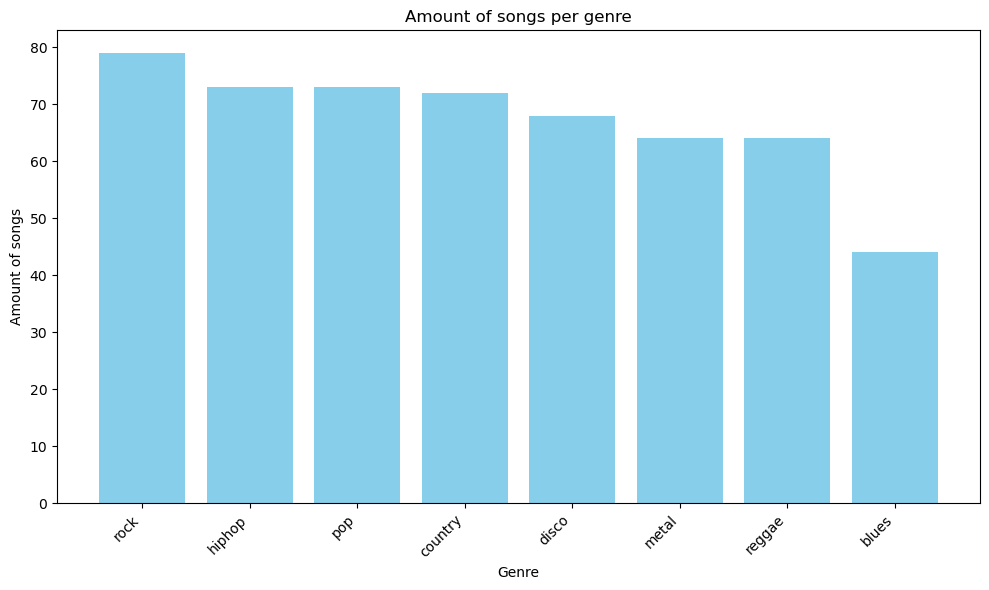

In [19]:
genres = tekst["genre"].value_counts().index
aantallen = tekst["genre"].value_counts().values

plt.figure(figsize=(10, 6))
plt.bar(genres, aantallen, color='skyblue')
plt.title('Amount of songs per genre')
plt.xlabel('Genre')
plt.ylabel('Amount of songs')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In de dataset zitten in totaal 8 genres, waarvan de data niet helemaal goed is verdeeld. Zo zie je dat de genres rock, hiphop, pop en country ongeveer even veel liedjes heeft van ronde de 75. Het genre blues heeft echter maar 44 liedjes, dat is minder dan de helft, dus hopelijk zal dit niet voor problemen zorgen tijdens het trainen van de modelen.

In [20]:
tekst['lyrics_length'] = tekst['lyrics'].apply(lambda x: sum(len(line) for line in x))
tekst

,filename,lyrics,genre,lyrics_length
0,blues.00001.wav,I’m in the Mood Lyrics[Verse 1]\nI'm in the mo...,blues,706
1,blues.00002.wav,"(John Lee Hooker)\nThink twice before you go, ...",blues,755
2,blues.00003.wav,"[Intro, Spoken]\n...A little thing I'm going t...",blues,1456
3,blues.00005.wav,"Sugar mama, sugar mama, sugar mama please come...",blues,1318
4,blues.00006.wav,My baby left me this morning\nPeople just arou...,blues,713
...,...,...,...,...
532,rock.00094.wav,[Chorus]\nDon’t stop\nIsn’t it funny how you s...,rock,793
533,rock.00096.wav,"[Verse 1]\nHer hair, soft drifted snow\nDeath ...",rock,1155
534,rock.00097.wav,[Verse 1]\nYour knuckles whiten on the wheel\n...,rock,1214
535,rock.00098.wav,[Verse 1]\nYou know it\nYou show it\nAnd the t...,rock,1002


Om te kunnen kijken op welke plekken er nog meer onderscheid is tussen de genres berekenen wij de lengte van een songtekst. Zo kunnen wij berekenen welk genre gemiddeld het meeste aantal woorden gebruikt in hun teksten en zo misschien betere voorspellingen kan doen.

In [21]:
tekst_lens = tekst.groupby("genre")["lyrics_length"].mean()
tekst_lens

genre
blues       893.704545
country    2174.333333
disco      2699.058824
hiphop     4677.986301
metal      4417.203125
pop        2312.410959
reggae     1638.734375
rock       1274.594937
Name: lyrics_length, dtype: float64

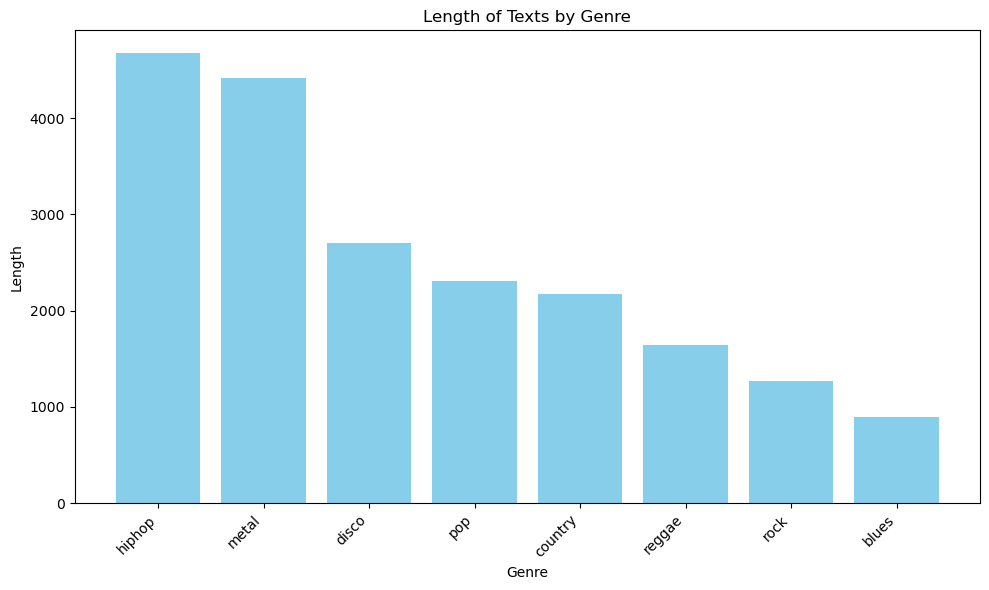

In [22]:
sorted_df = tekst_lens.sort_values(ascending=False)

plt.figure(figsize=(10, 6))
plt.bar(sorted_df.index, sorted_df.values, color='skyblue')
plt.title('Length of Texts by Genre')
plt.xlabel('Genre')
plt.ylabel('Length')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

Wanneer er gekeken wordt naar de gemiddelde lengtes van de teksten per genre valt het meteen op dat er een stuk meer tekst zit in liedjes met het genre hiphop en pop dan in liedjes als reggae, rock en blues. Het is goed om te zien dat hier zo'n groot verschil in zit, omdat dit hoop geeft op de voorspellingen die uiteindelijk gemaakt moeten worden.

In [23]:
def top_5_common_words(df):
    """
    Find the top 5 most common words in the lyrics for each genre in the dataframe.

    Parameters:
    -----------
    df (DataFrame): A pandas DataFrame containing 'genre' and 'lyrics' columns.

    Returns:
    --------
    dict: A dictionary where keys are genres and values are lists of the top 5 most common words
        in the lyrics associated with each genre.
    """
    top_5_per_genre = {}

    for genre, text in zip(df['genre'], df['lyrics']):
        words = text.lower().split()
        words = [word.strip('.,!?;:"()[]{}') for word in words]

        # Top 5 meest voorkomende woorden per genre
        top_5_words = Counter(words).most_common(5)
        top_5_per_genre[genre] = [word for word, freq in top_5_words]

    return top_5_per_genre

In [24]:
most_common = top_5_common_words(tekst)
for genre, common in most_common.items():
    print(f"De meest voorkomende woorden in het genre '{genre}' zijn: {common}")

De meest voorkomende woorden in het genre 'blues' zijn: ["i'm", 'your', 'iceman', 'my', 'baby']
De meest voorkomende woorden in het genre 'country' zijn: ['to', 'this', 'we', 'be', 'the']
De meest voorkomende woorden in het genre 'disco' zijn: ['hey', 'he', 'was', 'a', 'the']
De meest voorkomende woorden in het genre 'hiphop' zijn: ['the', 'fight', 'power', 'to', 'you']
De meest voorkomende woorden in het genre 'metal' zijn: ['the', 'on', 'yeah', 'come', 'a']
De meest voorkomende woorden in het genre 'pop' zijn: ['do', 'you', 'be', 'baby', 'always']
De meest voorkomende woorden in het genre 'reggae' zijn: ['capone', 'al', "don't", 'my', 'name']
De meest voorkomende woorden in het genre 'rock' zijn: ['the', 'this', 'is', 'one', 'for']


Als laatste onderscheid dat wij willen maken kijken wij nog naar de top 5 van de meest voorkomende woorden per genre. Hieruit kan niet een heel groot onderscheid gemaakt worden, omdat de top 5 bestaat uit random, veel voorkomende woorden en je ziet woorden als "the", "do"/"don't", "be" in meerdere teksten terug komen. Daarom verwachten wij niet dat het model met enkel de woorden goede voorspellingen kan maken.

https://chat.openai.com/c/bafd8dfa-3131-44be-a5da-6483beeb7f48

<a name='2.4'></a>
<h3>&sect;2.4: Conclusie EDA</h3>

Uit onze EDA zijn een aantal belangrijke punten naar boven gekomen. Zo weten wij dat ieder audio bestand ongeveer 30 seconden lang is. Dat is fijn wanneer wij met de data moeten gaan modelleren, omdat het dan een stuk sneller gaat dan met audio bestanden van 30 seconden. Daarnaast zijn wij er achter gekomen dat er een groot verschil is in de genres wanneer er gekeken wordt naar de lengte van de teksten van een lied. Gemiddeld heeft een hiphop nummer meer tekst van een blues nummer. Deze informatie laat ons geloven dat een model relatief goed kan voorspellen met tekst data als deze de lengte van de teksten mee neemt tijdens het trainen. Verder weten wij nu ook hoe veel genres in de dataset zitten, wat helpt bij het maken van een model. Zo weten wij precies wat de laatste (output) laag van ons model moet zijn. Om de data nog beter voor te bereiden op het trainen zijn er nog een aantal toevoegingen die gedaan kunnen worden om meer duidelijke verschillen te kunnen zien in de data. Deze voegen wij toe in het volgende hoofdstuk waar wij ook uiteindelijk de data gaan trainen en onze eerste voorspellingen gaan maken.

[Back to the top](#start)
<a name='3.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H3: LSTM voor audioclips</strong></h2>
</div>

<a name='3.1'></a>
<h3>&sect;3.1: Feature engineering</h3>

Voor het voorbereiden van de data hebben wij insprantie gehaald uit de lesopdracht van week 7, les 1 (LSTM_voor_timeseries_data_–_classificatie_van_audioclips, 2024)

In [25]:
for audio_batch, label_batch in train_ds.take(1):
    print("Shape of an audio sample:", audio_batch[0].shape)

Shape of an audio sample: (661500,)


In [26]:
def get_spectrogram(waveform):
    """
    Convert a waveform into a spectrogram representation.

    Parameters:
    -----------
    waveform (Tensor): The input audio waveform.

    Returns:
    --------
    Tensor: The spectrogram representation of the input waveform.
    """
    spectrogram = tf.signal.stft(waveform, frame_length=512, frame_step=256)
    spectrogram = tf.abs(spectrogram)
    spectrogram = spectrogram[..., tf.newaxis]
    return spectrogram

Als eerste stap in het feature engineeren maken wij een functie aan die de spectrogram van ieder audio bestand berekend. Dit is een feature die veel kan zeggen over een bepaald audio bestand. In een andere paragraaf wordt er dieper ingegaan op de specrogrammen en de reden waarom wij deze hebben gekozen om toe te voegen aan onze data.

In [27]:
def make_spec_ds(ds):
    def map_func(audio, *args):
        """
        Map function to convert audio samples to spectrograms.

        Parameters:
        -----------
        audio: Audio waveform.
        *args: Additional arguments, if any.

        Returns:
        --------
        tuple or Tensor: If additional arguments are provided, returns a tuple containing
            the spectrogram and the first additional argument. Otherwise, returns just the spectrogram.
        """
        spectrogram = get_spectrogram(audio)
        if len(args) > 0:
            return spectrogram, args[0]
        else:
            return spectrogram
    return ds.map(
        map_func,
        num_parallel_calls=tf.data.AUTOTUNE)

Na het berekenen van de spectrogrammen bij de data moeten ze worden toegewezen aan de data. Dat gebeurd met de functie die hierboven is gedefinieerd.

In [28]:
train_spectrogram_ds = make_spec_ds(train_ds)
val_spectrogram_ds = make_spec_ds(val_ds)
test_spectrogram_ds = make_spec_ds(test_ds)
test_spectrogram_ds_kaggle = make_spec_ds(test_ds_kaggle)

In [29]:
train_spectrogram_ds =train_spectrogram_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
val_spectrogram_ds = val_spectrogram_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_spectrogram_ds = test_spectrogram_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_spectrogram_ds_kaggle = test_spectrogram_ds_kaggle.cache().prefetch(buffer_size=tf.data.AUTOTUNE)

In [30]:
for audio_batch, label_batch in train_spectrogram_ds.take(1):
    print("Shape of an audio sample:", audio_batch[0].shape)

Shape of an audio sample: (2582, 257, 1)


Na het maken van de functies moeten ze nog gebruikt worden. In de cellen hierboven worden eerst de spectrogrammen berekend van de audio bestanden. In de cel daaronder worden de waardes toegevoegd aan de data en als laatste wordt er weergeven hoe de data er uit ziet na het toevoegen van de spectrogrammen.

In [31]:
def spectrogram_to_mfcc(spectrograms, num_mel_bins=128, num_coefficients=20, sample_rate=16000):
    """
    Convert a batch of spectrograms to a batch of 1D time series of MFCCs.

    Parameters:
    - spectrograms: A TensorFlow Tensor representing a batch of spectrograms with shape (batch_size, 311, 257, 1).
    - num_mel_bins: Number of Mel bins to use.
    - num_coefficients: Number of MFCC coefficients to return.
    - sample_rate: Sample rate of the audio.

    Returns:
    - A TensorFlow Tensor containing the MFCCs with shape (batch_size, num_frames, num_coefficients).
    """
    spectrograms = tf.squeeze(spectrograms, axis=-1)
    stfts_to_mel_matrix = tf.signal.linear_to_mel_weight_matrix(
        num_mel_bins=num_mel_bins,
        num_spectrogram_bins=spectrograms.shape[-1],
        sample_rate=sample_rate,
        lower_edge_hertz=20.0,
        upper_edge_hertz=sample_rate / 2)
    mel_spectrograms = tf.tensordot(spectrograms, stfts_to_mel_matrix, 1)
    
    mel_spectrograms.set_shape(spectrograms.shape[:-1] + (num_mel_bins,))
    log_mel_spectrograms = tf.math.log(mel_spectrograms + 1e-6)
    mfccs = tf.signal.mfccs_from_log_mel_spectrograms(log_mel_spectrograms)[..., :num_coefficients]
    return mfccs

Daarna kiezen wij er voor om nog een feature toe te voegen aan onze data, ook wel de MFCC's. Meer uitleg over de reden van de keuze van deze feature en uitleg wat deze feature inhoudt komt in een latere paragraaf aan bot. In de functie hierboven maken wij alleen nog maar de waardes van de features aan.

In [32]:
def make_MFCC_ds(ds):
    """
    Convert a spectrogram dataset into a dataset of Mel-frequency cepstral coefficients (MFCCs).

    Parameters:
    ds (tf.data.Dataset): The input spectrogram dataset.

    Returns:
    --------
    tf.data.Dataset: The dataset of MFCCs.
    """
    def map_func(spectrogram, *args):
        mfcc = spectrogram_to_mfcc(spectrogram)
        if len(args) > 0:
            return mfcc, args[0]
        else:
            return mfcc
    return ds.map(map_func, num_parallel_calls=tf.data.AUTOTUNE)

Na het berekenen van de MFCC's moeten ze ook nog toegevoegd worden aan de data, wat gebeurd in de functie hierboven. 

In [33]:
train_MFCC_ds = make_MFCC_ds(train_spectrogram_ds)
val_MFCC_ds = make_MFCC_ds(val_spectrogram_ds)
test_MFCC_ds = make_MFCC_ds(test_spectrogram_ds)
test_MFCC_ds_kaggle = make_MFCC_ds(test_spectrogram_ds_kaggle)

In [34]:
for example_MFCC, example_MFCC_labels in train_MFCC_ds.take(1):
    break

In [35]:
example_MFCC

<tf.Tensor: shape=(8, 2582, 20), dtype=float32, numpy=
array([[[ 2.96543159e+01, -4.47349787e+00, -5.18117547e-01, ...,
         -2.02537560e+00, -1.51318312e+00, -1.69813335e-01],
        [ 2.40344658e+01, -3.87670422e+00,  9.84676421e-01, ...,
          1.81373060e-01, -7.94304252e-01, -1.53001559e+00],
        [ 2.00727959e+01, -3.87621570e+00,  8.58344138e-01, ...,
          3.59606482e-02, -1.27561212e+00, -4.07347083e-01],
        ...,
        [ 9.33076668e+00, -8.64122772e+00,  3.08272624e+00, ...,
          8.78024578e-01,  9.05242562e-01, -9.42370772e-01],
        [ 1.05039549e+01, -1.02095919e+01,  1.28495908e+00, ...,
          3.50657105e-01, -7.64176369e-01, -1.05844760e+00],
        [ 1.19136314e+01, -9.52755165e+00,  2.05389357e+00, ...,
          6.38983473e-02, -1.03160214e+00, -7.13330150e-01]],

       [[-3.97491150e+01,  7.82315159e+00, -2.13192292e-02, ...,
          4.70582128e-01, -4.25013870e-01,  1.31164157e+00],
        [-3.13124771e+01,  6.43072367e+00, -1.02

In [36]:
train_MFCC_ds = train_MFCC_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
val_MFCC_ds = val_MFCC_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_MFCC_ds = test_MFCC_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_MFCC_ds_kaggle = test_MFCC_ds_kaggle.cache().prefetch(buffer_size=tf.data.AUTOTUNE)

In [37]:
for audio_batch, label_batch in train_MFCC_ds.take(1):
    print("Shape of an audio sample:", audio_batch[0].shape)

Shape of an audio sample: (2582, 20)


In de cellen hierboven worden de twee functies van de MFCC's toegepast. Als eerste gebruiken wij de functie die de MFCC's bij de data berekend. Daarna voegen wij deze waardes toe aan de data zodat wi nu overblijven met een dataset van audio bestanden inclusief de spectrogrammen en de MFCC's. Ook maken wij de variabelen example_MFCC en example_MFCC_labels aan, om te kijke hoe de data er nu uit ziet. De shape hiervan wordt gebruikt als input shape van ons eerste model. Als laatste printen wij de shape van onze data hoe het er nu uitziet, na het toevoegen van de MFCC's.

<a name='3.2'></a>
<h3>&sect;3.2: Het model</h3>

In [38]:
input_shape = example_MFCC.shape[1:]

model_lstm = models.Sequential([
    layers.Input(shape=input_shape),
    Bidirectional(LSTM(64, return_sequences=True, kernel_regularizer=regularizers.l2(0.01))),
    Dropout(0.5),
    BatchNormalization(),
    Bidirectional(LSTM(32, return_sequences=True, kernel_regularizer=regularizers.l2(0.01))),
    Dropout(0.5),
    BatchNormalization(),
    Bidirectional(LSTM(16, return_sequences=False, kernel_regularizer=regularizers.l2(0.01))),
    Dropout(0.5),
    BatchNormalization(),
    Dense(8, activation='softmax')
])
model_lstm.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 2582, 128)         43520     
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 2582, 128)         0         
                                                                 
 batch_normalization (Batch  (None, 2582, 128)         512       
 Normalization)                                                  
                                                                 
 bidirectional_1 (Bidirecti  (None, 2582, 64)          41216     
 onal)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 2582, 64)          0         
                                                        

<a name='3.3'></a>
<h3>&sect;3.3: Modelarchitectuur</h3>

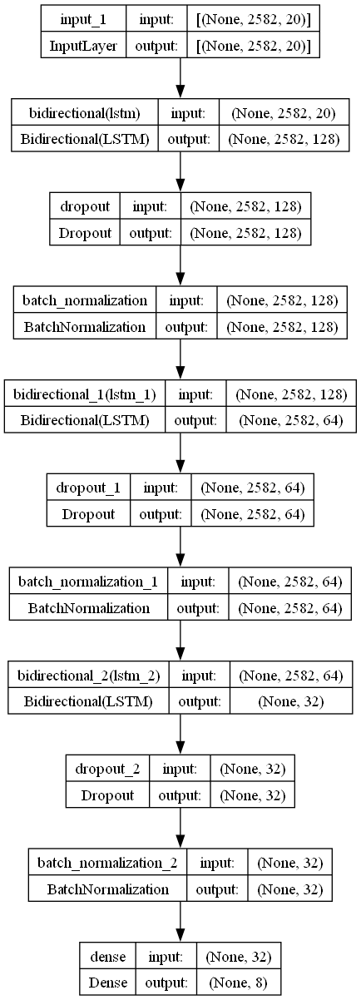

In [39]:
tf.keras.utils.plot_model(model_lstm, to_file='LSTM_audio.png', show_shapes=True, show_layer_names=True)

<a name='3.4'></a>
<h3>&sect;3.4: Stappen feature engineering</h3>

Voor het voorspellen van genres van een lied met audio data is het handig om een aantal features toe te voegen aan de data, zodat er meer data gebruikt wordt tijdens het trainen en er betere voorspellingen gedaan kunnen worden. Als eerst hebben wij er voor gekozen om spectorgrams toe te voegen aan onze audio bestanden. Een spectrogram is een visuele representatie van een audiobestand met 3 features. Als eerst heb je op de X-as de tijd van het bestand, op de y-as de frequentie van het audiobestand en de kleur geeft de amplitude aan van de audiobestanden. Deze kleur kan lichtere of donkere tonen aangeven wat dan ook aan geeft of er verschil is in de data. Door het toevoegen van spectrogrammen aan je trainingsdata kunnen er makkelijker patronen herkent worden wat uiteindelijk resulteert in betere voorspellingen (Seeing Sound: What Is A Spectrogram?, 2018).

Naast het toevoegen van de spectrogrammen hebben wij er ook voor gekozen om de MFCC's van de audiobestanden toe te voegen aan de data. MFCC staat voor Mel-frequency cepstrum wat slaat op een groep features, vaak tussen de 10 en de 20, die de algemene vorm van de spectrale envelop beschrijven. Wij hebben er voor gekozen om 20 features toe te voegen, zodat er meer data gebruikt kan worden tijdens het trainen. Onze data bevatte eerst namelijk alleen de audiobestanden en de spectrogrammen. De MFCCs worden dan ook afgeleid uit de data van de spectrogrammen. (Deruty, 2022)

Na creëren van alle functies voor het toevoegen van de nieuwe feautres worden ze gebruikt en hebben we een nieuwe dataset met een hoop nieuwe features dus kunnen helpen bij het correct voorspellen van de genres bij de nummers. Dit doen wij ook voor de uiteindelijke test data, zodat deze gebruikt kan worden om onze prestaties te testen op kaggle.

<a name='3.5'></a>
<h3>&sect;3.5: Onderbouwing keuzes parameters</h3>

- Sequential: Om een LSTM model te maken beginnen we met het initialiseren van een Sequential model. Wij hebben er voor gekozen om een aantal features toe te voegen aan de data waardoor wij als input shape de shape gebruiken van de "example_MFCC" variabele. Hierin is de shape te vinden van de uiteindelijke trainingsdata.

- Om een goed model te trainen is het goed om lagen te maken met neuronen met een even getal. Het beste is wanneer het getal van de volgende laag de helft is van de laag ervoor, omdat de data op deze manier het beste leert van de vorige data. Wij hebben er voor gekozen om een model te maken met 3 Bidirectional LSTM lagen. Een normale LSTM laag kijkt alleen naar één laag terug in het verleden terwijl een Bidirectional LSTM laag kijkt naar zowel één laag uit het verleden en één laag in de toekomst. Wij hebben er voor gekozen om deze laag te gebruiken, omdat het meer informatie gebruikt tijdens het trainen wat voor ons voordelig is. 
    - Lagen: Wij beginnen in de eerste laag met 64 neuronen, in de tweede laag met 32 neuronen en in de derde laag met 16 neuronen. Wij bouwen steeds af in het aantal neuronen zodat het model goed de patronen in de data kan leren. Wij beginnen bij de 64, omdat onze output laag uiteindelijk 8 genres moet kunnen voorspellen, wat weer de helft is van 16, waar we in de derde laag op uit komen. Als laatste hebben we aan deze LSTM lagen ook een regulizer toegevoegd. De regulizer die wij hebben toegevoegd is de L2, die gewichten van features richting de 0 brengt maar wel behoudt, wat goed is voor onze data, omdat wij niet veel data hebben, dus geen informatie willen verliezen. 
    - Dropout: Tussen elk van de Bidirectional LSTM lagen wordt er een dropout laag toegevoegd. Een dropout van 0.5 houdt in dat er tijdens het trainen 50 procent van de nodes, van die laag, wordt uitgezet en de nodes die uitvallen zijn random gekozen.
    - Normalization: Naast het toevoegen van een dropout laag tussen alle Bidirectional LSTM lagen, wordt er ook een Batch Normalisatie toegevoegd tussen iedere laag. Hierin wordt de input data genormaliseerd waardoor het gemiddelde 0 is en de standaarddeviatie 1.
    - Ouput laag: Om het model af te sluiten moet er een output laag aangemaakt worden die aangeeft hoeveel mogelijke uitkomsten het model zou moeten kunnen voorspellen. Voor de opdracht moeten wij genres voorspellen wat een totaal heeft van 8 genres. Daarom hebben wij een output laag van 8, met een activatiefunctie "softmax". Dit is de activatifunctie die gebruikt wordt wanneer er meerdere categorieën voorspeld moeten worden.
   
Na het toevoegen van al deze lagen aan het model kan het model getraind worden op onze data, die uiteindelijk gebruikt kan worden op de ongeziene data om de genres te voorspellen.

<a name='3.6'></a>
<h3>&sect;3.6: Geschikte loss functie en optimizer</h3>

Buiten het opstellen van het aantal lagen, aantal neuronen, activatie functies en het aantal epochs is het ook belangrijk om uit te zoeken welke loss functie en optimizer het best gebruikt kan worden voor ons model.

- Loss functie: Voordat we een goede loss functie kunnen kiezen voor ons model is het als aller eerste belangrijk dat er gekeken wordt naar de opdracht. Voor dit portfolio is het de bedoeling om met de hulp van data voorspellingen te maken van een bepaald genre waar een liedje tot toe behoord. Het aantal genres dat wij hebben in onze train dataset is 8. Dat wilt zeggen dat wij bezig zijn met een classificatie taak waar 8 verschillende uitkomsten mogelijk zijn. Daarom kiezen wij er voor om gebruik te maken van de loss functie "sparse categorical cross entropy". De reden dat wij niet gewoon categorical cross entropy gebruiken is, omdat deze loss functie alleen one-hot encoded labels accepteert. Wij maken gebruik van simpele integer labels die wel geaccepteerd worden met een sparse categorical cross entropy loss functie. Op deze manier kunnen wij ons model goed trainen met de correcte loss functie.

- Optimizer: De optimizer die wij gebruiken voor ons LSTM audio model is de Adam optimizer. Dit staat voor Adaptive moment estimator en kan goed omgaan met ruis in de data. Ook hebben wij er voor gekozen om deze optimizer te kiezen, omdat hij snel en efficiënt werkt met grote hoeveelheden data. Wij werken voor deze portfolio opdrachten met audio data van 30 seconde, waar features aan zijn toegevoegd. Dit betekent dan ook dat de data groter en groter is geworden en het veel tijd nodig heeft om te trainen. Hierom hebben wij ervoor gekozen om ons model te compileren met de Adam optimizer.
    - Werking van de optimizer Adam: Adam houdt tijdens het trainen twee momenten van de gradiënt bij. Ten eerste berekent het, net als de SGD-optimizer, het gemiddelde van de gradiënten. Daarnaast berekent het ook het gemiddelde van de kwadraten van de gradiënten, een extra stap die de SGD-optimizer niet kent. Vervolgens past Adam verschillende leersnelheden toe op elk gewicht, gebaseerd op deze momenten. Bovendien gebruikt Adam informatie over hoe de loss functie verandert ten opzichte van de verschillende parameters van het model om te beslissen welke richting hij moet nemen om de fout te verkleinen. Het past de grootte van de stapjes aan op basis van de grootte van de gradiënt en past ook de richting aan om de meest efficiënte weg naar beneden te vinden. Op deze manier kan Adam snel en slim leren om het model te verbeteren.
    
- Metrics: De uiteindelijke metrics die wij gebruiken om ons model te trainen in de accuracy. De reden dat wij deze metric gebruiken is, omdat wij willen weten hoe goed ons model presteert door te kijken hoe veel van de liedjes een goed voorspellend genre hebben gekregen. 

<a name='3.7'></a>
<h3>&sect;3.7: Model trainen</h3>

In [40]:
stop_early = EarlyStopping(monitor='val_loss', patience=5)

In [41]:
model_lstm.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                   loss="sparse_categorical_crossentropy",
                   metrics=["accuracy"])
history_lstm = model_lstm.fit(train_MFCC_ds, epochs=100, validation_data=val_MFCC_ds, batch_size=30)

Epoch 1/100
54/54 [==============================] - 255s 4s/step - loss: 6.6803 - accuracy: 0.1767 - val_loss: 6.0615 - val_accuracy: 0.2941
Epoch 2/100
54/54 [==============================] - 251s 5s/step - loss: 6.0119 - accuracy: 0.2860 - val_loss: 5.5657 - val_accuracy: 0.3725
Epoch 3/100
54/54 [==============================] - 270s 5s/step - loss: 5.4939 - accuracy: 0.3209 - val_loss: 5.2172 - val_accuracy: 0.3725
Epoch 4/100
54/54 [==============================] - 266s 5s/step - loss: 5.0970 - accuracy: 0.3628 - val_loss: 4.9103 - val_accuracy: 0.3922
Epoch 5/100
54/54 [==============================] - 263s 5s/step - loss: 4.7018 - accuracy: 0.3767 - val_loss: 4.5481 - val_accuracy: 0.3922
Epoch 6/100
54/54 [==============================] - 265s 5s/step - loss: 4.3860 - accuracy: 0.3884 - val_loss: 4.2605 - val_accuracy: 0.4118
Epoch 7/100
54/54 [==============================] - 258s 5s/step - loss: 4.0974 - accuracy: 0.4023 - val_loss: 4.0985 - val_accuracy: 0.3725
Epoch 

In [42]:
last_acc_audio = history_lstm.history['val_accuracy'][-1]
print("Last Validation Accuracy Audio LSTM:", last_acc_audio)

Last Validation Accuracy Audio LSTM: 0.4313725531101227


<a name='3.8'></a>
<h3>&sect;3.8: Loss visualisatie</h3>

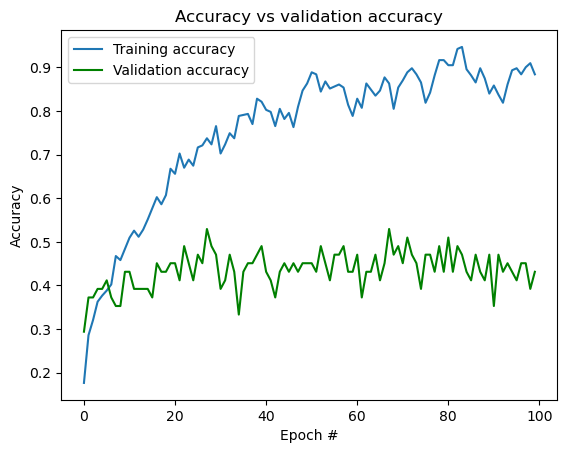

In [43]:
plt.plot(history_lstm.history['accuracy'], label='Training accuracy')
plt.plot(history_lstm.history['val_accuracy'], 'g', label='Validation accuracy')
plt.xlabel('Epoch #')
plt.ylabel('Accuracy')
plt.title('Accuracy vs validation accuracy')
plt.legend()
plt.show()

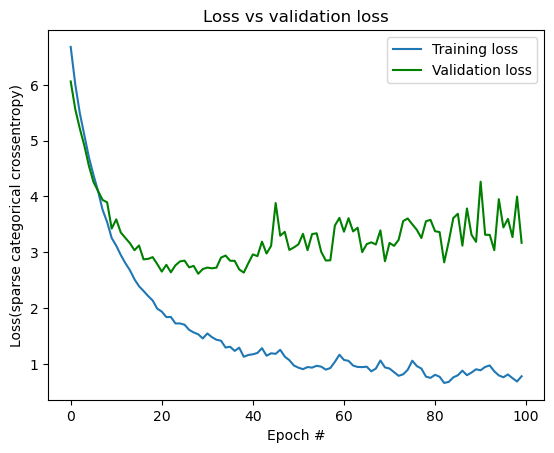

In [44]:
plt.plot(history_lstm.history['loss'], label='Training loss')
plt.plot(history_lstm.history['val_loss'], 'g', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('Loss(sparse categorical crossentropy)')
plt.title('Loss vs validation loss')
plt.legend()
plt.show()

##### Epochs: 
Het aantal epochs die wij gebruiken voor dit model is 100. Het is een model die er lang over doet om één epoch te runnen, dus wij kiezen er voor om er niet meer te laten runnen. Ook valt het in de visualisaties op dat de training resultaten en validatie resultaten uit elkaar lopen hoe meer epochs er worden getraind. De reden dat wij er niet voor kiezen om te trainen op minder epochs komt door de toegevoegd early stopping in het trainingsproces. Er is voor het trainen aangegeven dat er gestopt kon worden op het moment dat er meer dan 5 validatie losses achter elkaar daalde. Omdat dit bij ons na 100 epochs runnen niet is gebeurt kiezen wij er voor om toch de gehele run af te maken, omdat zo minder spraken is van overfitting.

<a name='3.9'></a>
<h3>&sect;3.9: Functie voor kaggle</h3>

Om te kunnen controleren hoe goed onze modellen werken hebben wij een functie gemaakt genaamd "to_kaggle" dat een DataFrame aanmaakt die op kaggle gezet kan worden. De functie slaat het DataFrame ook meteen op waardoor het meteen op kaggle gepusht kan worden om te controleren hoe goed het model heeft gepresteerd.

In [45]:
def to_kaggle(model, predict, naam):
    """
    Generates predictions using the provided model for the given data and writes the results to a CSV
        file in the Kaggle competition format.

    Parameters:
    -----------
    model (object): The trained machine learning model used for prediction.
    predict (array-like): The data to be used for prediction.
    naam (str): The filename for the output CSV file.

    Returns:
    --------
    pandas.DataFrame: A DataFrame containing the filenames and predicted genres.
    """
    predictions = model.predict(predict)
    filenames = [f"test.{i:05}.wav" for i in range(129)]
    predicted_classes = np.argmax(predictions, axis=1)
    
    predicted_genres = [label_names[class_idx] for class_idx in predicted_classes]
    data = list(zip(filenames, predicted_genres))
    inleveren_kaggle = pd.DataFrame(data, columns=['filename', 'genre'])


    print(inleveren_kaggle)
    return inleveren_kaggle.to_csv(naam, index=False)

In [46]:
to_kaggle(model_lstm, test_MFCC_ds_kaggle, 'LSTM_audio_kaggle_2.csv')

17/17 [==============================] - 12s 535ms/step
           filename    genre
0    test.00000.wav      pop
1    test.00001.wav    disco
2    test.00002.wav   reggae
3    test.00003.wav     rock
4    test.00004.wav  country
..              ...      ...
124  test.00124.wav  country
125  test.00125.wav    blues
126  test.00126.wav   hiphop
127  test.00127.wav  country
128  test.00128.wav     rock

[129 rows x 2 columns]


[Back to the top](#start)
<a name='4.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H4: LSTM voor songteksten</strong></h2>
</div>

<a name='4.1'></a>
<h3>&sect;4.1: Datapipeline met data preprocessing, feature engineering, of/en data augmentation</h3>

Voor de inspiratie van data preprocessing voor tekst data hebben wij gebruik gemaakt van twee bronnen. : Ngyptr, (2018) en Li, (2021). Uit deze bronnen hebben wij gekeken naar de beste manieren om een tekst voor te bereiden en hebben op basis hiervan onze data gepreprocest.

In [5]:
tekst

,filename,lyrics,genre
0,blues.00001.wav,I’m in the Mood Lyrics[Verse 1]\nI'm in the mo...,blues
1,blues.00002.wav,"(John Lee Hooker)\nThink twice before you go, ...",blues
2,blues.00003.wav,"[Intro, Spoken]\n...A little thing I'm going t...",blues
3,blues.00005.wav,"Sugar mama, sugar mama, sugar mama please come...",blues
4,blues.00006.wav,My baby left me this morning\nPeople just arou...,blues
...,...,...,...
532,rock.00094.wav,[Chorus]\nDon’t stop\nIsn’t it funny how you s...,rock
533,rock.00096.wav,"[Verse 1]\nHer hair, soft drifted snow\nDeath ...",rock
534,rock.00097.wav,[Verse 1]\nYour knuckles whiten on the wheel\n...,rock
535,rock.00098.wav,[Verse 1]\nYou know it\nYou show it\nAnd the t...,rock


De eerste stap van het preprocessing is om de lyrics the "tokenizen". Dit zet alle woorden om naar getallen zodat een model het kan gebruiken. Verder filteren we ook onnodige tekens etc. uit de woorden.

In [11]:
max_words = 3000
max_sequence_length = 250
embedding_dim = 100

tokenizer = Tokenizer(num_words=max_words, filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', lower=True)
tokenizer.fit_on_texts(tekst['lyrics'])
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 16390 unique tokens.


Hier truncaten (inkorten) en padden (opvullen) we de inputs zodat ze allemaal dezelfde lengte hebben.

In [12]:
X = tokenizer.texts_to_sequences(tekst['lyrics'].values)
X = tf.keras.preprocessing.sequence.pad_sequences(X, maxlen=max_sequence_length)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (537, 250)


Labels encoden

In [13]:
Y = pd.get_dummies(tekst['genre']).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (537, 8)


In [22]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.1, random_state = 42)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

(483, 250) (483, 8)
(54, 250) (54, 8)


<a name='4.2'></a>
<h3>&sect;4.2: Het model</h3>

In [23]:
model = Sequential()
model.add(Embedding(max_words, embedding_dim, input_length=X.shape[1]))
model.add(SpatialDropout1D(0.7))
model.add(LSTM(64, dropout=0.7, recurrent_dropout=0.7))
model.add(Dense(8, activation='softmax'))

<a name='4.3'></a>
<h3>&sect;4.3: Modelarchitectuur</h3>

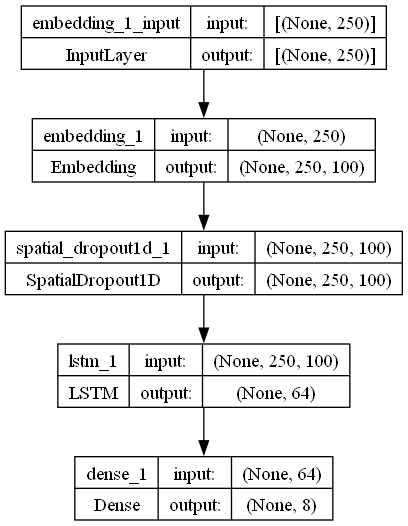

In [20]:
tf.keras.utils.plot_model(model, to_file='LSTM_tekst.png', show_shapes=True, show_layer_names=True)

<a name='4.4'></a>
<h3>&sect;4.4: Onderbouwing keuzes parameters</h3>

- Sequential: Om een LSTM model te maken moeten we eerst een Sequentieel model initieren.
- We beginnen met een embedded layer met 100 vectoren. Deze vectoren worden gebruikt om elk woord te representeren. Deze vectoren bepalen dus welke woorden/sequences op elkaar lijken. De size van de input is simpelweg de lengte van X.
- SpatialDropout1D doet het zelfde als een normale dropout layer. I.e. willekeurig inputs naar 0 zetten en andere inputs scalen om overfitting te voorkomen. Het verschil met 1D is dat het ook features dropped die op elkaar lijken. Dit is dus goed voor ons model omdat de vectoren aan ons vertellen welke features op elkaar lijken.
- Hierna komt de LSTM layer met 64 units.
- De output layer heeft 8 waardes, omdat we 8 classes hebben.
- "Softmax" wordt gebruikt omdat het een multi-class classificatie probleem is. Dit is een functie die een standaard exponentiele functie toepast op elke element in de input vector.
- Ook "categorical_crossentropy" wordt gebruikt omdat we met een multi-class probleem te maken hebben. Normale cross entropy kan niet worden gebruikt omdat het ervan uitgaat dat er maar twee classes zijn.

<a name='4.5'></a>
<h3>&sect;4.5: Model trainen</h3>

In [24]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

epochs = 100
batch_size = 128

history_text= model.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,validation_split=0.2)

Epoch 1/100
4/4 [==============================] - 5s 459ms/step - loss: 2.0816 - accuracy: 0.1269 - val_loss: 2.0760 - val_accuracy: 0.1753
Epoch 2/100
4/4 [==============================] - 2s 386ms/step - loss: 2.0755 - accuracy: 0.1632 - val_loss: 2.0736 - val_accuracy: 0.1856
Epoch 3/100
4/4 [==============================] - 2s 376ms/step - loss: 2.0719 - accuracy: 0.1658 - val_loss: 2.0715 - val_accuracy: 0.1546
Epoch 4/100
4/4 [==============================] - 2s 386ms/step - loss: 2.0658 - accuracy: 0.1995 - val_loss: 2.0693 - val_accuracy: 0.1546
Epoch 5/100
4/4 [==============================] - 2s 380ms/step - loss: 2.0660 - accuracy: 0.1554 - val_loss: 2.0667 - val_accuracy: 0.1856
Epoch 6/100
4/4 [==============================] - 2s 408ms/step - loss: 2.0593 - accuracy: 0.2124 - val_loss: 2.0637 - val_accuracy: 0.1959
Epoch 7/100
4/4 [==============================] - 2s 391ms/step - loss: 2.0550 - accuracy: 0.2202 - val_loss: 2.0605 - val_accuracy: 0.2268
Epoch 8/100
4

Epoch 59/100
4/4 [==============================] - 2s 448ms/step - loss: 0.9694 - accuracy: 0.7435 - val_loss: 1.9209 - val_accuracy: 0.4124
Epoch 60/100
4/4 [==============================] - 2s 477ms/step - loss: 0.9424 - accuracy: 0.7461 - val_loss: 1.8572 - val_accuracy: 0.3918
Epoch 61/100
4/4 [==============================] - 2s 455ms/step - loss: 0.9760 - accuracy: 0.7306 - val_loss: 2.2169 - val_accuracy: 0.3299
Epoch 62/100
4/4 [==============================] - 2s 473ms/step - loss: 1.0304 - accuracy: 0.6762 - val_loss: 2.3443 - val_accuracy: 0.2474
Epoch 63/100
4/4 [==============================] - 2s 460ms/step - loss: 1.0752 - accuracy: 0.6736 - val_loss: 2.2743 - val_accuracy: 0.3402
Epoch 64/100
4/4 [==============================] - 2s 465ms/step - loss: 1.1376 - accuracy: 0.6321 - val_loss: 2.2588 - val_accuracy: 0.2165
Epoch 65/100
4/4 [==============================] - 2s 422ms/step - loss: 1.0099 - accuracy: 0.7124 - val_loss: 1.8152 - val_accuracy: 0.4124
Epoch 

In [25]:
last_acc_text = history_text.history['val_accuracy'][-1]
print("Last Validation Accuracy Text LSTM:", last_acc_text)

Last Validation Accuracy Text LSTM: 0.4020618498325348


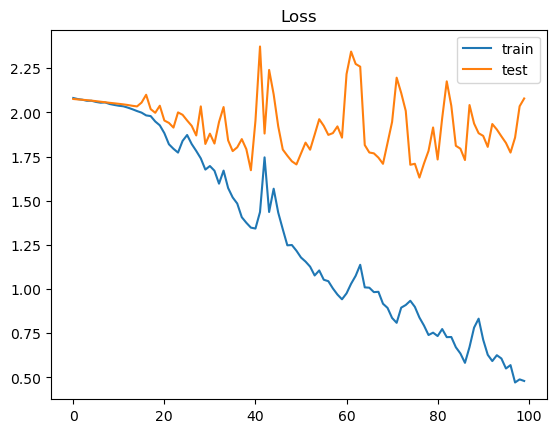

In [26]:
plt.title('Loss')
plt.plot(history_text.history['loss'], label='train')
plt.plot(history_text.history['val_loss'], label='test')
plt.legend()

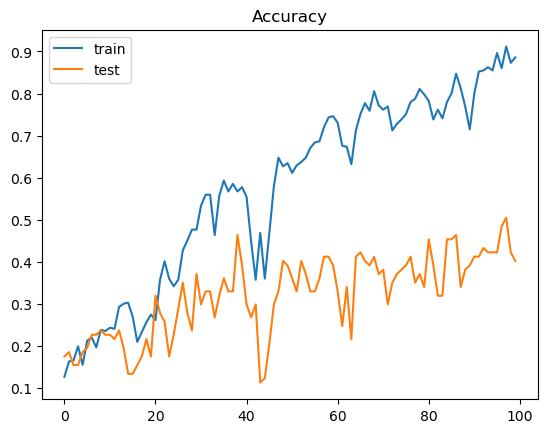

In [27]:
plt.title('Accuracy')
plt.plot(history_text.history['accuracy'], label='train')
plt.plot(history_text.history['val_accuracy'], label='test')
plt.legend()

[Back to the top](#start)
<a name='5.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H5: Transformer voor songteksten</strong></h2>
</div>

In [21]:
tekst

,filename,lyrics,genre,lyrics_length
0,blues.00001.wav,I’m in the Mood Lyrics[Verse 1]\nI'm in the mo...,blues,706
1,blues.00002.wav,"(John Lee Hooker)\nThink twice before you go, ...",blues,755
2,blues.00003.wav,"[Intro, Spoken]\n...A little thing I'm going t...",blues,1456
3,blues.00005.wav,"Sugar mama, sugar mama, sugar mama please come...",blues,1318
4,blues.00006.wav,My baby left me this morning\nPeople just arou...,blues,713
...,...,...,...,...
532,rock.00094.wav,[Chorus]\nDon’t stop\nIsn’t it funny how you s...,rock,793
533,rock.00096.wav,"[Verse 1]\nHer hair, soft drifted snow\nDeath ...",rock,1155
534,rock.00097.wav,[Verse 1]\nYour knuckles whiten on the wheel\n...,rock,1214
535,rock.00098.wav,[Verse 1]\nYou know it\nYou show it\nAnd the t...,rock,1002


<a name='5.1'></a>
<h3>&sect;5.1: Het model</h3>

In [ ]:
#Het pretrained model inladen, we hebben hier bij geforceerd dat nu met 8 labels werken
model_name = "juliensimon/autonlp-song-lyrics-18753417"
model = AutoModelForSequenceClassification.from_pretrained(model_name,num_labels=8,  ignore_mismatched_sizes=True)
tokenizer = AutoTokenizer.from_pretrained(model_name)
#train val splits van de data maken
train_texts, val_texts, train_labels, val_labels = train_test_split(
    tekst['lyrics'],  
    tekst['genre'],   
    test_size=0.2,    
    random_state=42   
)

#tokenizer toepassen op de data
train_encodings = tokenizer(train_texts.tolist(), truncation=True, padding=True)
val_encodings = tokenizer(val_texts.tolist(), truncation=True, padding=True)

# labels naar cijfers veranderen zodat het voor het model gebruikt kan worden
label2id = {label: i for i, label in enumerate(set(train_labels))}
num_labels = len(label2id)

train_labels = [label2id[label] for label in train_labels]
val_labels = [label2id[label] for label in val_labels]


# Een pytorch dataset class maken zodat de data in het model gebruikt kan worden
class SongDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        item['labels'] = torch.tensor(self.labels[idx])
        return item

    def __len__(self):
        return len(self.labels)
#maken van de train en val dataset
train_dataset = SongDataset(train_encodings, train_labels)
val_dataset = SongDataset(val_encodings, val_labels)

# Training argumenten maken voor het fine tunen van het model
training_args = TrainingArguments(
    output_dir="./results", 
    num_train_epochs=3,
    per_device_train_batch_size=2,
    per_device_eval_batch_size=2,
    logging_dir="./logs",
    logging_steps=100,
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    learning_rate=2e-5,
)
#Het maken van een accuracy functie zodat bij het fine tunen van het model de accuracy weergeven wordt
accuracy_metric = load_metric("accuracy")
def compute_metrics(eval_pred):
    logits, labels = eval_pred

    logits_tensor = torch.from_numpy(logits)

    predictions = torch.argmax(logits_tensor, dim=-1)
    accuracy = accuracy_metric.compute(predictions=predictions, references=labels)["accuracy"]


    return {"accuracy": accuracy}

# Trainer class aanpassen zodat die werkt voor ons probleem
class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels")
        outputs = model(**inputs)
        logits = outputs.logits
        loss_fn = torch.nn.CrossEntropyLoss()
        loss = loss_fn(logits, labels)
        return (loss, outputs) if return_outputs else loss
# Trainer maken met al de benodigde dingen
trainer = CustomTrainer(
    model=model, 
    args=training_args,  
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics,
)

# Het pre-trained model fine tunen
trainer.train()

# Evaluatie
results = trainer.evaluate()
print(results)

#Voor makkelijkste genre voorspellen later
prediction_genre = trainer.predict(val_dataset)
predicted_label_genre_indices = prediction_genre.argmax(axis=1)

# Get actual labels
true_labels = val_labels

# Convert indices to labels
predicted_genre = [list(label2id.keys())[list(label2id.values()).index(label_id)] for label_id in predicted_label_indices]
true_labels = [list(label2id.keys())[list(label2id.values()).index(label_id)] for label_id in true_labels]

het runnen van het model is gedaan in een ander collab bestand dus hier is de uitkomst ervan:
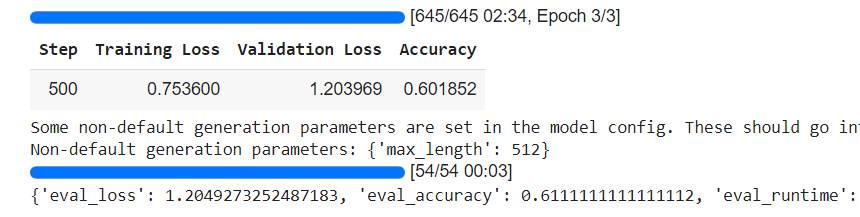

Je ziet hierboven dat het model dus een val loss van 1.2~ heeft en een eval_accuracy van 0.6111~ heeft. Hoewel dit niet heel hoog is heeft die op kaggle een stuk beter gescoord. Je ziet hier ook al dat bij de laaste 145 stappen de eval_loss omhoog gegaan is dus dat het model al begon te overfitten.

<a name='5.2'></a>
<h3>&sect;5.2: Fine-tuning Hugging Face</h3>

Je ziet in de training_args dat we het model hebben gefinetuned doormiddel van 3 epochs, we hebben maar 3 epochs gebruikt omdat we merkte dat het model snel ging overfitten (bij 5 epochs was die al erg overfit), ook duurde het model aardig lang om te runnen dus scheelde dat ook veel tijd. We hebben maar een kleine batch size van 2 gebruikt omdat onze gpu ram al snel vol raakte. De 500 eval_steps slaat hierop na hoeveel stappen van het model het een evaluatie laat zien. We hebben een learning rate van 0.00002 gebruikt, dit hebben we gebruikt om dat dit een learning rate is die vaak gebruikt wordt bij transformer model en het hier ook goed werkte. We hebben ook het aantal classes dat het model gebruikt naar 8 veranderd omdat we 8 genres hadden.

In [ ]:
last_acc_transf = '0.6111111111111112'
print("Last Validation Accuracy Transformer model:", last_acc_tranfs)

<a name='5.3'></a>
<h3>&sect;5.3: Naam modelarchitectuur en dataset</h3>

In [ ]:
#stukje code om een png van het model archituur te krijgen, dit is gebruikt omdat dit origineel gerund is in google colab
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
example_input = tokenizer("This is an example input sentence", return_tensors="pt")
example_input = {k: v.to(device) for k, v in example_input.items()} 
example_outputs = model(**example_input)
graph = make_dot(example_outputs.logits, params=dict(model.named_parameters()))

graph.render("model_architecture", format="png")

We hebben hier het model 'autonlp-song-lyrics-18753417' van juliensimon gebruikt, dit model is getrained op BERT.
Het architectuur ziet er zo uit:


<a name='5.4'></a>
<h3>&sect;5.4: Voordelen vooraf getrainde tekstmodellen</h3>

Er zijn veel voordelen bij het gebruik van een vooraf getrainde tekstmodellen, een paar van de belangrijkste voordelen voor ons zijn dat je minder gegevens hoeft te hebben, efficientie en tekst bevatting.

Omdat een vooraf getrainde tekstmodel al getrained is op heel veel data heeft het al een goed begrip van taal hierdoor kan je doormiddel van fine tunen een model al snel met minder data goede prestaties laten behalen.

De vooraf getrainde tekstmodel is al op heel veel data getrained en heeft hiervoor ook veel rekenkracht en tijd gehad, dit zouden wij zelf voor zo'n project nooit kunnen nabootsen. Hierdoor kunnen we dus zelf goede resultaten behalen met tekst data zonder veel rekenkracht of tijd nodig te hebben.

Het model is al getrained op heel veel data, hierdoor heeft het geleerd om complexe patronen en structuren in taal op te vatten. Zulke dingen zouden wij met onze gelimiteerde rekenkracht en tijd nooit kunnen behalen. Hierdoor is het dus heel voordelig om een vooraf getrainde tekstmodel te gebruiken zodat je snel goede resultaten haalt.

<a name='5.5'></a>
<h3>&sect;5.5: Predicties en bestand maken voor kaggle</h3>

In [ ]:
#een zelfde soort class maken as bij het finetunen is gebruikt, alleen nu zonder labels
class TestDataset(torch.utils.data.Dataset):
    def __init__(self, encodings):
        self.encodings = encodings

    def __getitem__(self, idx):
        return {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}

    def __len__(self):
        return len(self.encodings.input_ids)

#De test data preparen voor het model doormiddel van een tokenizer
test_texts =   test['lyrics']
test_encodings = tokenizer(test_texts.tolist(), truncation=True, padding=True)
#de data in een dataset stoppen
test_dataset = TestDataset(test_encodings)
#het model laten predicten, gebruiken we ook voor het ensemble model.
predictions = trainer.predict(test_dataset)
#De correcte label uitkiezen (die met de hoogste waarde)
predicted_label_indices = predictions.predictions.argmax(-1)
#De label weer linken aan de correct genre
predicted_labels = [list(label2id.keys())[list(label2id.values()).index(label_id)] for label_id in predicted_label_indices]
#Maken van een list voor de filenames (kwam er achteraf pas achter dat die ookal in tekst stond)
filenames = [f"test.{i:05}.wav" for i in range(129)]
#de genres en filenames bij elkaar zetten
data = list(zip(filenames, predicted_labels))
#ze in een dataframe stoppen en de correcte kolomnamen geven
inleveren_kaggle = pd.DataFrame(data, columns=['filename', 'genre'])
#het in csv formaat exporteren
inleveren_kaggle.to_csv('ensemble.csv', index=False)

[Back to the top](#start)
<a name='6.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H6: Model naar keuze</strong></h2>
</div>

<a name='6.1'></a>
<h3>&sect;6.1: Het model</h3>

In [ ]:
#We hebben voor de verschillende modellen dezelfde code gebruikt als voor het transformer model maar met een ander model, ook 
#zijn de training argumenten wat anders, voor uitleg kijk daar.
#Ook is voor de ensemble het transformer model ook gebruikt, deze zal ik hier niet herhalen.
#model 2

model_name = "vagrawal787/bert-finetuned-lyrics-genres"
model = AutoModelForSequenceClassification.from_pretrained(model_name,num_labels=8,  ignore_mismatched_sizes=True)
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts, val_texts, train_labels, val_labels = train_test_split(
    tekst['lyrics'],  
    tekst['genre'],   
    test_size=0.2,    
    random_state=42   
)

train_encodings = tokenizer(train_texts.tolist(), truncation=True, padding=True)
val_encodings = tokenizer(val_texts.tolist(), truncation=True, padding=True)

label2id = {label: i for i, label in enumerate(set(train_labels))}
num_labels = len(label2id)

train_labels = [label2id[label] for label in train_labels]
val_labels = [label2id[label] for label in val_labels]

train_dataset = SongDataset(train_encodings, train_labels)
val_dataset = SongDataset(val_encodings, val_labels)

training_args = TrainingArguments(
    output_dir="./results", 
    num_train_epochs=3,  
    per_device_train_batch_size=1,  
    per_device_eval_batch_size=1,   
    logging_dir="./logs",  
    logging_steps=100,
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    learning_rate=2e-5,
)


trainer = CustomTrainer(
    model=model,  
    args=training_args,  
    train_dataset=train_dataset,  
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics,
)

trainer.train()

results = trainer.evaluate()
print(results)

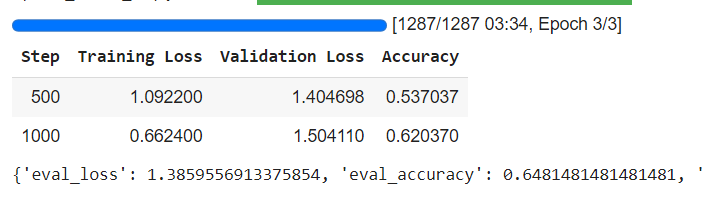

In [ ]:
#de predicties die we gebruiken voor onze ensemble
test_encodings = tokenizer(test_texts.tolist(), truncation=True, padding=True)
test_dataset = TestDataset(test_encodings)
predictions2 = trainer.predict(test_dataset)

In [ ]:
#model 3

model_name = "vagrawal787/bert-finetuned-lyrics-genres-v2"
model = AutoModelForSequenceClassification.from_pretrained(model_name,num_labels=8,  ignore_mismatched_sizes=True)
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts, val_texts, train_labels, val_labels = train_test_split(
    tekst['lyrics'],  
    tekst['genre'],   
    test_size=0.2,    
    random_state=42   
)

train_encodings = tokenizer(train_texts.tolist(), truncation=True, padding=True)
val_encodings = tokenizer(val_texts.tolist(), truncation=True, padding=True)

label2id = {label: i for i, label in enumerate(set(train_labels))}
num_labels = len(label2id)

train_labels = [label2id[label] for label in train_labels]
val_labels = [label2id[label] for label in val_labels]

train_dataset = SongDataset(train_encodings, train_labels)
val_dataset = SongDataset(val_encodings, val_labels)

training_args = TrainingArguments(
    output_dir="./results",
    num_train_epochs=3, 
    per_device_train_batch_size=1, 
    per_device_eval_batch_size=1, 
    logging_dir="./logs", 
    logging_steps=100,
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    learning_rate=2e-5,
)

trainer = CustomTrainer(
    model=model,  
    args=training_args,  
    train_dataset=train_dataset,  
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics,
)

trainer.train()

results = trainer.evaluate()
print(results)

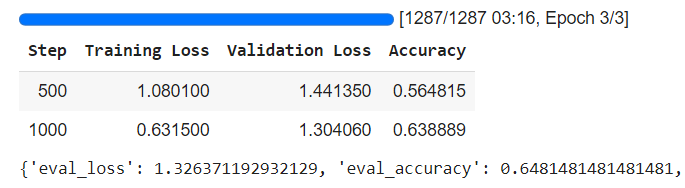

In [ ]:
#de predicties die we gebruiken voor onze ensemble
test_encodings = tokenizer(test_texts.tolist(), truncation=True, padding=True)
test_dataset = TestDataset(test_encodings)
predictions3 = trainer.predict(test_dataset)

In [ ]:
#model 4

model_name = "Veucci/lyric-to-genre"
model = AutoModelForSequenceClassification.from_pretrained(model_name,num_labels=8,  ignore_mismatched_sizes=True)
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts, val_texts, train_labels, val_labels = train_test_split(
    tekst['lyrics'],  
    tekst['genre'],   
    test_size=0.2,    
    random_state=42   
)

train_encodings = tokenizer(train_texts.tolist(), truncation=True, padding=True)
val_encodings = tokenizer(val_texts.tolist(), truncation=True, padding=True)

label2id = {label: i for i, label in enumerate(set(train_labels))}
num_labels = len(label2id)

train_labels = [label2id[label] for label in train_labels]
val_labels = [label2id[label] for label in val_labels]

train_dataset = SongDataset(train_encodings, train_labels)
val_dataset = SongDataset(val_encodings, val_labels)

training_args = TrainingArguments(
    output_dir="./results",
    num_train_epochs=5, 
    per_device_train_batch_size=1, 
    per_device_eval_batch_size=1, 
    logging_dir="./logs", 
    logging_steps=100,
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    learning_rate=2e-5,
)

trainer = CustomTrainer(
    model=model,  
    args=training_args,  
    train_dataset=train_dataset,  
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics,
)

trainer.train()

results = trainer.evaluate()
print(results)

Deze kreeg een hele lage accuracy maar wel een hele hoge kaggle score, daarom hebben we deze toch gebruikt voor de ensemble
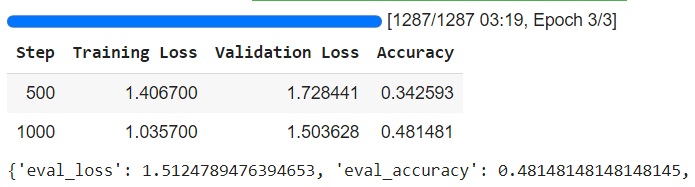

In [ ]:
#de predicties die we gebruiken voor onze ensemble
test_encodings = tokenizer(test_texts.tolist(), truncation=True, padding=True)
test_dataset = TestDataset(test_encodings)
predictions4 = trainer.predict(test_dataset)

In [ ]:
#model 7

model_name = "ProsusAI/finbert"
model = AutoModelForSequenceClassification.from_pretrained(model_name,num_labels=8,  ignore_mismatched_sizes=True)
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts, val_texts, train_labels, val_labels = train_test_split(
    tekst['lyrics'],  
    tekst['genre'],   
    test_size=0.2,    
    random_state=42   
)

train_encodings = tokenizer(train_texts.tolist(), truncation=True, padding=True)
val_encodings = tokenizer(val_texts.tolist(), truncation=True, padding=True)

label2id = {label: i for i, label in enumerate(set(train_labels))}
num_labels = len(label2id)

train_labels = [label2id[label] for label in train_labels]
val_labels = [label2id[label] for label in val_labels]

train_dataset = SongDataset(train_encodings, train_labels)
val_dataset = SongDataset(val_encodings, val_labels)

training_args = TrainingArguments(
    output_dir="./results",
    num_train_epochs=3, 
    per_device_train_batch_size=1, 
    per_device_eval_batch_size=1, 
    logging_dir="./logs", 
    logging_steps=100,
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    learning_rate=2e-5,
)

trainer = CustomTrainer(
    model=model,  
    args=training_args,  
    train_dataset=train_dataset,  
    eval_dataset=val_dataset,
    compute_metrics=compute_metrics,
)

trainer.train()

results = trainer.evaluate()
print(results)

Dit model is met wat meer epochs getrained om dat model niet al getrained was op lyrics
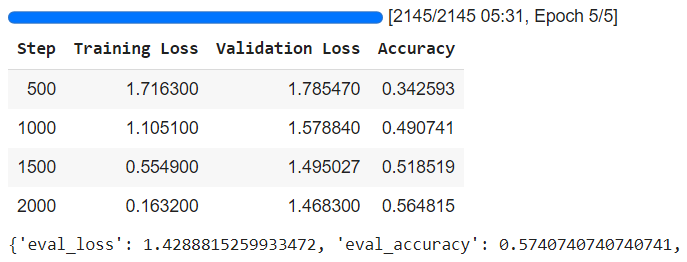

In [ ]:
#de predicties die we gebruiken voor onze ensemble
test_encodings = tokenizer(test_texts.tolist(), truncation=True, padding=True)
test_dataset = TestDataset(test_encodings)
predictions7 = trainer.predict(test_dataset)

In [ ]:
#correcte data uit de predictions halen
predictions_array = predictions[0]
predictions2_array = predictions2[0]
predictions3_array = predictions3[0]
predictions4_array = predictions4[0]
predictions7_array = predictions7[0]
#het bij elkaar stoppen van de predicties met de gewilde weights
weight_predictions = [
    (predictions_array, 10),
    (predictions2_array, 1),
    (predictions3_array, 2),
    (predictions4_array, 3),
    (predictions7_array, 5)  
]
#uitvoeren weights en bij elkaar optrekken
weighted_sum = sum(weight * pred for pred, weight in weight_predictions)
#totale weights
total_weight = sum(weight for _, weight in weight_predictions)

#gemiddelde resultaat van de ensemble
avg_pred_array = weighted_sum / total_weight

predicted_label_indices = avg_pred_array.argmax(-1)

predicted_labels = [list(label2id.keys())[list(label2id.values()).index(label_id)] for label_id in predicted_label_indices]

data = list(zip(filenames, predicted_labels))
inleveren_kaggle = pd.DataFrame(data, columns=['filename', 'genre'])
inleveren_kaggle.to_csv('ensemble8.csv', index=False)

<a name='6.2'></a>
<h3>&sect;6.2: Modelarchitectuur</h3>

De architecturen zijn op de zelfde manier gekregen als het transformer model, voor de code kunt U daar kijken. Ook zal ik het architectuur van het eerste model ook niet hier weer plaatsen.

Model 2:


Model 3:


Model 4:


Model 7:


<a name='6.3'></a>
<h3>&sect;6.3: Uitleg keuzes model</h3>

We wouden eerst een soort ensemble/multi modaal model maken van een transformer voor de lyrics en een transformer voor de audio data, jammer genoeg is na veel tijd er ingestoken te hebben is de transformer voor de audio nooit goed gaan werken. Toen hebben we gekozen voor optie b, een ensemble model met meerdere transformers voor lyrics. We hebben hiervoor gekozen omdat het transformer model bij verre het beste resultaat gaf en dus een ensemble van meerdere van dezelfde soort modellen (met dus wel andere base modellen) een beter en robusture resultaten zou geven. We hebben hiervoor 5 modellen gebruikt: juliensimon/autonlp-song-lyrics-18753417, vagrawal787/bert-finetuned-lyrics-genres, vagrawal787/bert-finetuned-lyrics-genres-v2, Veucci/lyric-to-genre en ProsusAI/finbert.

juliensimon/autonlp-song-lyrics-18753417 is hetzelfde model als het model die we voor de transformer model gebruikt hebben en dus voor verdere uitleg daarover kunt U daar kijken. Dit model is vooraf al getrained op lyrics data en gebruikt BERT. We hebben dit model een weight van 10 gegeven omdat die bij verre de beste kaggle scoren gaf.

vagrawal787/bert-finetuned-lyrics-genres:
Dit model is ook vooraf getrained op lyrics en maakt ook gebruik van BERT. De training argumenten die we gebruikt hebben zijn bijna hetzelfde als die voor het transformer model, dit hebben we gedaan omdat dat hiervoor al goed werkte en na het testen hierbij ook goed werkte. Het enigste wat verandert is is dat de batch size naar 1 gezet is omdat bij het runnen van 5 modellen de gpu snel vol zat. We hebben dit model een weight van 1 gegeven omdat het eigenlijk al bijna hetzelfde is als het model hieronder maar net wat slechter, hierdoor hebben we gekozen om ze samen 3 te geven (deze 1 en de ander 2) omdat de kaggle score van deze niet heel goed was.

vagrawal787/bert-finetuned-lyrics-genres-v2:
Wij zijn er te laat pas achtergekomen dat dit model een versie 2 was van het model hierboven, hierdoor geldt hetzelfde voor dit model als dat model. Als we dit eerder wisten hadden we een ander model gebruikt omdat het niet handig is om 2x bijna hetzelfde base-model te gebruiken. Hierdoor is namelijk de kans dat die overfit op dit model groter. Dit model heeft een weight van 2 gekregen.

Veucci/lyric-to-genre:
Dit model is weer getrained op lyrics data en maakt gebruikt van BERT. Hierdoor hebben we weer dezelfde training argumenten geven als hierboven. Het model presteerde op kaggle ongeveer even goed als de vagrawal modellen daarom hebben we het een weight van 3 gegeven.

ProsusAI/finbert:
Dit is het enige model dat niet getrained is op lyrics vooraf, hij maakt wel gebruik van BERT. Dit model is getrained op financiele tekst. We hebben express voor nog een model gekozen dit niet al gefinetuned was op lyrics zodat het uiteindelijke ensemble wat robuster is. Omdat dit model niet getrained is op lyrics maar op financiele tekst hebben we met model 5 epochs gegeven in plaats van 3 omdat het iets langer nodig had om goed voor deze data te trainen. Hierdoor is het model wel redelijk overfit geraakt maar zonder dit te doen gaf het niet een goed resultaat. Voorderest zijn de training argumenten hetzelfde als de rest. We hebben dit model een weight van 5 gegeven omdat die na het transformer model het beste resultaat gaf.

Bepaling waardes weights:
We hebben wel gekozen welke modellen we belangrijker wouden hebben voor de ensemble maar de exacte waardes zijn empirisch bepaald.

<a name='6.4'></a>
<h3>&sect;6.4: Model accuracy</h3>

In [ ]:
#we wisten niet hoe we de accuracy van het model zelf konden tonen dus hier de accuracies van de aparte modellen
last_acc_eigen = '0.6111111111111112, 0.6481481481481481, 0.6481481481481481, 0.48148148148148145, 0.5740740740740741'
print("Last Validation Accuracy Own Model:", last_acc_eigen)

[Back to the top](#start)
<a name='7.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H7: Bevindingen</strong></h2>
</div>

<a name='7.1'></a>
<h3>&sect;7.1: Samenvatting van de uitkomsten</h3>

##### Geef een beknopt overzicht van de resultaten

In [ ]:
print("LSTM Audio: ", last_acc_audio)
print("LSTM SOngteksten: ", last_acc_text)
print("Transformer model: ", last_acc_transf)
print("Eigen keuze model: ", last_acc_eigen)

##### Welke model presteert het beste? Bij welke parameters?

Het model dat voor ons het beste presteert is het Transformer model. Dit is een model wat al is gepre-traind met het doel om muziek genres af te leiden uit teksten. Het basis model wat wij in ons transformer model werkt dus goed met de taak die wij moeten uitvoeren, waardoor het ook voor ons logisch was dat dit model goed voor ons werkt. De parameters die hiervoor zijn gebruikt zijn de volgende:

training_args = TrainingArguments(

    - output_dir="./results",
    - num_train_epochs=3,
    - per_device_train_batch_size=2,
    - per_device_eval_batch_size=2,
    - logging_dir="./logs",
    - logging_steps=100,
    - evaluation_strategy="steps",
    - eval_steps=500,
    - save_steps=500,
    - learning_rate=2e-5,
)

Het basis transformer model wat is gebruikt voor het trainen van het model is het "juliensimon/autonlp-song-lyrics-18753417" model.

##### Toon je scores op Kaggle en laat zien wat de resultaten waren van je verbeteringen op je score op Kaggle.

Hieronder worden resultaten van enkele modellen getoond van Kaggle. Dit waren namelijk de modellen die een goede verbetering lieten zien met een verklaarbare reden.

# LSTM Audio

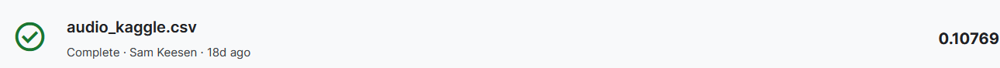

De eerste versie van het audio model die in Kaggle is getest is een model waar maar 3 epochs mee waren getraind om te kijken of het werkte en het formaat klopte. Ook was hier nog geen l2 regularisatie toegevoegd waardoor het model niet geweldig heeft gepresteerd op de ongeziene test data.

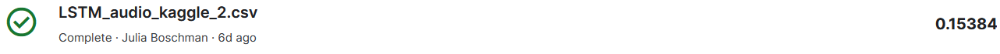

De tweede versie van het LSTM model met audio bestanden presteerde niet veel beter maar wel wat. Hieraan is het model getraind met 100 epochs en is er een regularisatie toegevoegd van l2 aan iedere laag van het model. Het model doet het beter, maar we verwachtte al dat dit niet het beste model ging woorden.

# Transformer model

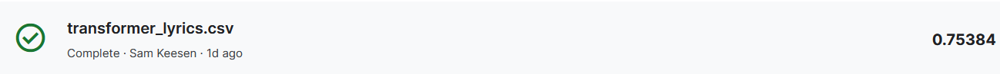

Het eerste transformer model wat wij hebben getest op Kaggle was meteen ons beste resultaat van deze competitie. We hebben gebruik gemaakt van een transformer model die gemaakt is om songteksten te gebruiken om te bepalen wat voor genre het liedje heeft. Bijna alle genres die wij moesten voorspellen waren aanwezig in het pre-traind model, waardoor het al veel had geleerd en met onze nieuwe data goed kon voorspellen.

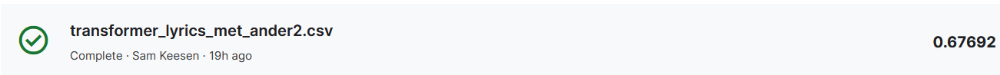

Na het succesvolle eerste resultaat van het transformer model zijn er nog een aantal pogingen geweest waarvan de hierboven getoonde score de hoogste was na de score van 0.75. Er is tijdens het trainen van het model gebruik gemaakt van een ander basis model, wat minder goed aansloot op onze opdracht en dus ook minder goede voorspellingen heeft kunnen maken.

# Model eigen keuze

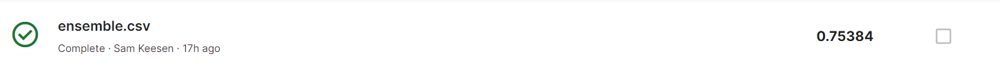

Het eerste ensemble model scoorde al gelijk heel hoog, net zo hoog als de transformer. Dit kwam waarschijnlijk omdat dat model ook gebruikt was voor deze ensemble. Hier waren er nog geen weights gebruikt en had elk model in het ensemble dus dezelfde weight.

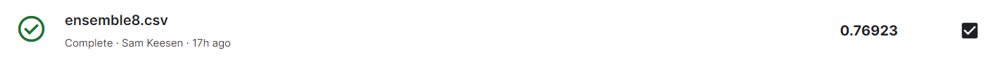

Dit is ons uiteindelijke ensemble model geworden, hij is maar net wat beter dan de eerste. We hebben deze betere score behaald door het ensemble uittesten met verschillende weights en hierbij is deze score bereikt.

[Back to the top](#start)
<a name='8.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H8: Conclusie en aanbevelingen</strong></h2>
</div>

<a name='8.1'></a>
<h3>&sect;8.1: Uitdagingen modelleringsproces</h3>

##### LSTM voor audio:
Bij het maken van een LSTM model voor het classificeren van audiobestanden aan verschillende genres had enkele uitdagingen. Als eerste bestond de data alleen uit audio fragmenten die erg moeilijk zijn om te begrijpen voor een model. Daarom was het nodig om een aantal features toe te voegen aan de data, zodat er makkelijker onderscheid gemaakt kon worden tussen de verschillende genres. Het was een uitdaging om uit te zoeken welke genres het beste toegevoegd konden worden aan de data en hoe dit dan ook geimplementeerd kon worden om een geheel dataset te maken met de nieuwe gegevens. Hiervoor zijn een aantal functies gebruik en dit was nog een beetje puzzelen en uitzoeken. Uiteindelijk was het ook erg vervelend dat het op een laptop zonder GPU erg lang duurde om het gehele model, met 100 epochs, te trainen waardoor het ook moeilijker was om even snel te kijken of nieuwe aanpassingen ook zorgen voor een beter resultaat. Het was dan ook jammer dat dit niet het model is geworden wat het beste heeft gepresteerd.

##### LSTM voor songsteksten:


##### Transformer model:
We hebben eigenlijk niet heel veel uitdagingen gehad bij dit model, de grootste uitdaging was het gebruiken van pytorch omdat we dit nog niet veel gebruikt hadden. We hebben voor een pytorch model gekozen omdat er geen goede model te vinden waren op huggingface die gebruikt konden worden met tensorflow/keras. Voor de rest was het eerste model dat we kozen gelijk een hele goede (en de beste die we gevonden hebben). Het enige echte probleem dat we bij het fine-tunen hadden was het model veranderen naar 8 labels. Wat na wat vogelen ook redelijk snel gefixt was.

##### Eigen keuze model:
De grooste uitdagingen voor het eigen keuze model zijn eigenlijk geweest bij het model die uiteindelijk niet gelukt was, hier is veel tijd ingestoken maar is jammer genoeg niet gelukt. Er waren hier veel uitdagingen met pytorch en het correct gebruiken van de audio data. Ook waren er problemen van het correct labelen van de test data. Bij het uiteindelijke ensemble model dat we gebruikt hebben waren er niet echt uitdagingen, dit komt omdat we haast alle code konden herbruiken van het transformer model. Het enige wat we moesten doen waren nieuwe modellen vinden en uittesten, de weights bepalen en het gemiddelde nemen van de predicties. Dit verliep eigenlijk zonder moeite.

<a name='8.2'></a>
<h3>&sect;8.2: Prestaties modelarchitecturen</h3>

Zoals hierboven al benoemd was het transformer model veruit het beste model met onze data. Wij hadden al wel verwacht dat een model beter om kan gaan met tekst data dan audio data. De reden dat wij dit denken is dan ook, omdat een model beter om kan gaan met getallen dan frequenties en geluid. Daarnaast hebben wij door dat het erg lasig is om uit een kort fragment van 30 seconden, of tekst, genoeg informatie te halen om correcte voorspellingen te doen. Daarom presteert het model met een vooraf getraind model beter dan een zelf gebouwd model.

<a name='8.3'></a>
<h3>&sect;8.3: Beste modellen audio en tekst</h3>

##### Audio:
Het audio model dat het beste heeft gepresteerd op onze data is het LSTM model, omdat dit het enige model is die vol gefocust is op de audio data. In het notebook is er een redelijke accuracy van 0.43, maar op Kaggle komt het niet boven de 0.15. Daarom kunnen we als nog niet zeggen dat het een goed model was.

##### Tekst: 
Ons beste tekst model was overduidelijk het transformer model wat op Kaggle een score van wel 0.75 heeft gehaald wat aangeeft dat 3/4 van de testdata zonder genres als nog goed is voorspeld. 

<a name='8.4'></a>
<h3>&sect;8.4: Genres makkelijk te voorspellen met audio en tekst</h3>

We hebben hiervoor het transformer model gebruikt

In [ ]:
print(classification_report(true_labels, predicted_genres))

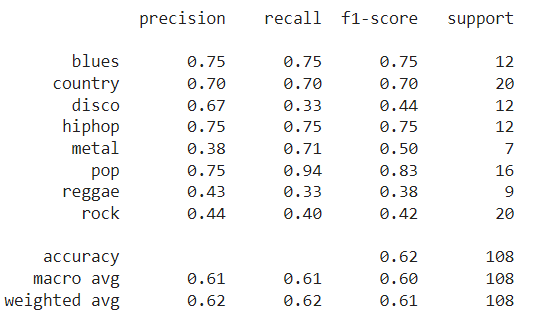

Je ziet hier dus dat meer dan de helft van de genres goed voorspeld (meer dan 0.66 precision), dit zijn de genres blues(0.75), country(0.70), disco(0.67), hiphop(0.75) en pop(0.75). De andere 3 genres scoort die een heel stuk slechter namelijke metal(0.38), reggae(0.43) en rock(0.44). Daarom zouden we ook aanraden om in het vervolg hier meer aandacht aan te besteden.

In [ ]:
conf_matrix = confusion_matrix(true_labels, predicted_genres)

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label2id.keys(), yticklabels=label2id.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

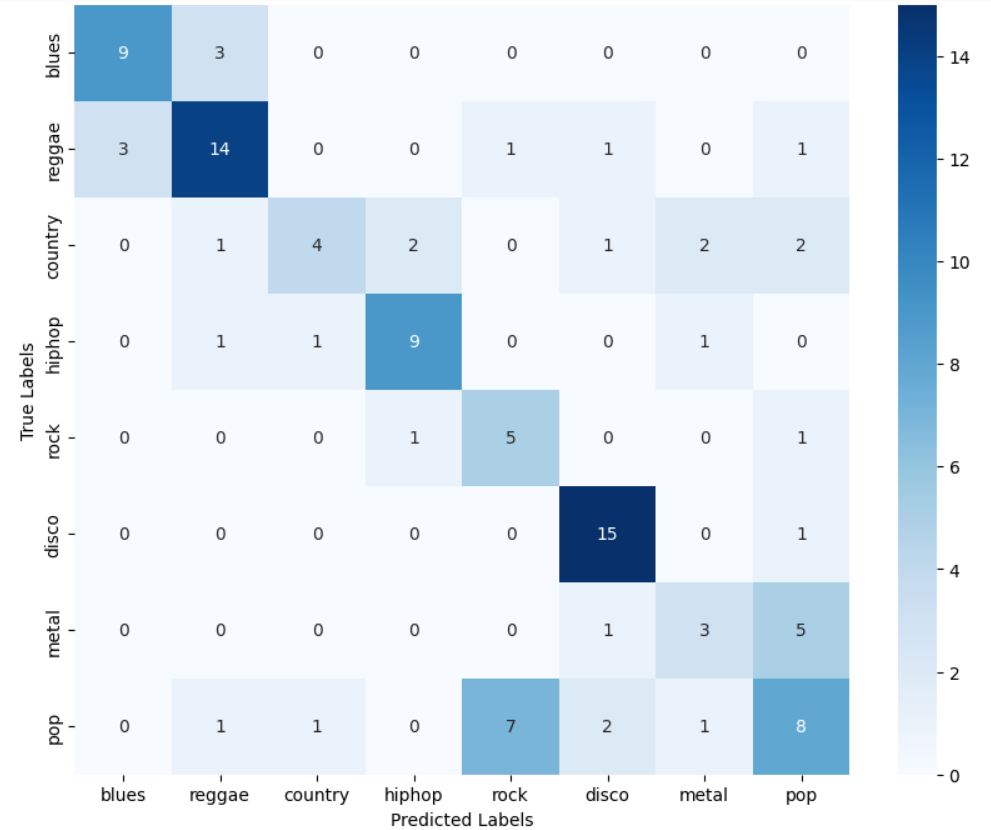

In de confusion matrix hierboven een heatmap van de voorspellingen, alles op de diagonale assen zijn de goede voorspellingen. Je ziet hier bijvoorbeeld dat hij pop vaak als rock voorspeld en dat hij vaak denkt dat metal pop is. Ook heeft die disco haast fouteloos voorspeld maar dat die wel vaak de label disco bij de een andere genre heeft gezet.

<a name='8.5'></a>
<h3>&sect;8.5: Advies voor app</h3>

Het advies wat wij zouden geven aan de mensen die een app zouden willen maken aan de hand van onze data is als eerst het gebruik maken van het transformer model die wij hebben gebruikt. Op Hugging Face kan de inhoud van het model bekeken worden en wij zouden het team aanraden hiernaar te kijken. Er is informatie te vinden zoals de genres die gerepresenteerd zijn in de data waarop het model getraind is. Zo kan er een selectie worden gemaakt van genres die hierin gerepresenteerd zijn met alle soorten genres. Omdat vaak niet alle genres muziek in zo'n vooraf getraind model staan raden wij het team ook aan na te denken over het bouwen van een eigen model voor op Hugging Face. Hierin zouden zij zelf kunnen bepalen op welke genres getraind kan worden en hier dus ook nieuwe genres aan toe voegen. 

<a name='8.6'></a>
<h3>&sect;8.6: Conceptuele uitbreiding voor systeem</h3>

Wij zouden goed na gaan of er transformer modellen zijn die echt alle genres bevatten die in onze dataset staan, zodat het model een hogere accuracy zou kunnen bereiken. Ook zouden wij gebruik maken van meer liedjes per genre die gebalanceerd verdeeld zijn. In de data zitten nu nog enkele genres die minder liedjes bevatten dan de andere waardoor het ook moeilijker wordt om alle genres even goed te kunnen voorspellen. Ook zouden wij er voor kunnen kiezen om alleen gebruik te maken van genres die ver uit elkaar liggen, zodat er makkelijker onderscheid gemaakt kan worden en wij met meer zekerheid een genre zouden kunnen voorspellen. Er zijn dus nog veel stappen die (conceptueel) ondernomen kunnen worden om de resultaten te verbeteren.

[Back to the top](#start)
<a name='9.0'></a>

<div style="background-color:#216375; text-align:center; vertical-align:middle; padding:10px 0; margin-top:5px; margin-bottom:5px">
        <h2 style="color:white"><strong>H9: Literatuurlijst</strong></h2>
</div>

##### EDA:
- Check audio’s sample rate using python. (n.d.). Stack Overflow. https://stackoverflow.com/questions/43490887/check-audios-sample-rate-using-python

##### LSTM Audio:
- Les opdracht Deep Learning week 7, les 1. Jupyter Notebook. http://localhost:8888/notebooks/Downloads/Jaar%202/Semester%202/Deep%20Learning/Week%207/Les%201/LSTM_voor_timeseries_data_%E2%80%93_classificatie_van_audioclips.ipynb
- Seeing sound: What is a spectrogram? (n.d.). Sound and Vision Blog. https://blogs.bl.uk/sound-and-vision/2018/09/seeing-sound-what-is-a-spectrogram.html
- Deruty, E. (2022, December 15). Intuitive understanding of MFCCs - Emmanuel Deruty - Medium. Medium. https://medium.com/@derutycsl/intuitive-understanding-of-mfccs-836d36a1f779

##### LSTM Songteksten:
- Ngyptr. (2018, May 22). Multi class classification with LSTM. Kaggle. https://www.kaggle.com/code/ngyptr/multi-class-classification-with-lstm
- Li, S. (2021, December 9). Multi-Class Text Classification with LSTM - Towards Data Science. Medium. https://towardsdatascience.com/multi-class-text-classification-with-lstm-1590bee1bd17

##### Transformer model:
-

##### Model naar keuze:
-